# Exercise 2: Nonlinear system of equations


Text(0.5, 1.0, 'Random, y-z phase plane')

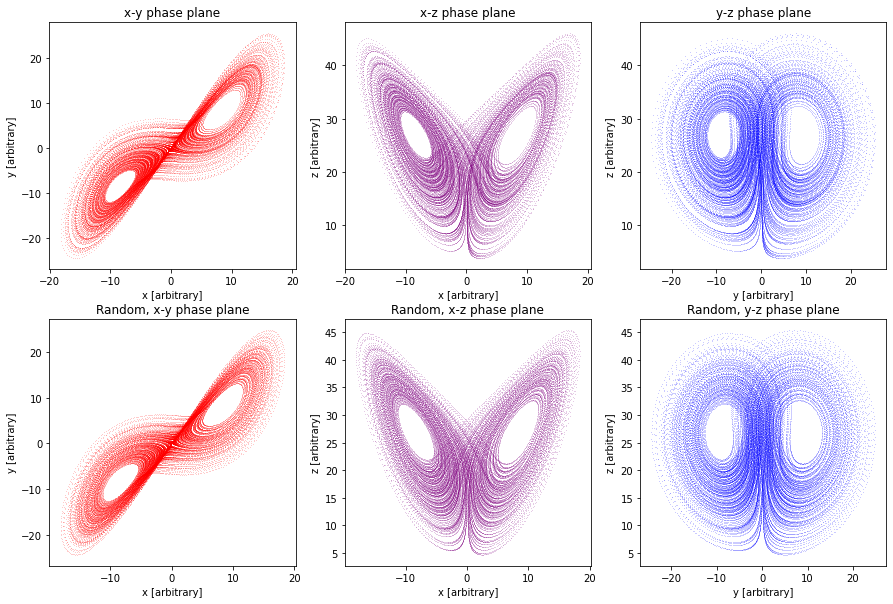

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from numpy import exp, cos
from scipy.integrate import odeint

# CONSTANTS ========================================================================
#Initial conditions from exercise document
initial_state = [0.1, 0, 0] 
initial_state_random = initial_state + np.random.randn(3)*(1e-10) #random initial conditions

sigma = 10.0
rho = 28.0
beta = 8/3

#assembling for use in odeint later
arguments = (sigma, rho, beta)

transient = 5000  # to remove any tail
npoints   = 50000 # number of points we're considering
t_end     = 200   # 200 seconds is more than enough
#timeline
t = np.linspace(0, t_end, npoints)

# FUNCTIONS ========================================================================

def lorenz_system(co_in, t, sigma, rho, beta):
    '''System of ODEs that describe the Lorenz system:
    Keyword Arguments:
        co_in -- x, y, z input coordinates
        t     -- time values
        sigma -- constant sigma
        rho   -- constant rho
        beta  -- constant beta
    returns:
        float, float, float -- lorenz system, x, y, z at time
    '''
    x, y, z = co_in #input values

    #the mathematics provided in document
    dxdt = sigma*(y-x)
    dydt = x*(rho-z)-y
    dzdt = x*y-beta*z

    return dxdt, dydt, dzdt

# MAGIC     ========================================================================

#non-random results
x, y, z = odeint(lorenz_system, initial_state, t, args=arguments).T
x = x[transient:] #remove the tail from the results
y = y[transient:]
z = z[transient:]

#random results
x_r, y_r, z_r= odeint(lorenz_system, initial_state_random, t, args=arguments).T
x_r = x_r[transient:] #remove the tail from the results
y_r = y_r[transient:]
z_r = z_r[transient:]

# PLOTS     ========================================================================
fig, ax = plt.subplots(2, 3, figsize=(15, 10))

# Plotting the non-random
ax[0, 0].scatter(x, y, color='red', marker='.', lw=0.1, s=0.5)
ax[0, 0].set_xlabel('x [arbitrary]')
ax[0, 0].set_ylabel('y [arbitrary]')
ax[0, 0].set_title('x-y phase plane')

ax[0, 1].scatter(x, z, color='purple', marker='.', lw=0.1, s=0.5)
ax[0, 1].set_xlabel('x [arbitrary]')
ax[0, 1].set_ylabel('z [arbitrary]')
ax[0, 1].set_title('x-z phase plane')

ax[0, 2].scatter(y, z, color='blue', marker='.', lw=0.1, s=0.5)
ax[0, 2].set_xlabel('y [arbitrary]')
ax[0, 2].set_ylabel('z [arbitrary]')
ax[0, 2].set_title('y-z phase plane')

#Plotting the Random
ax[1, 0].scatter(x_r, y_r, color='red', marker='.', lw=0.1, s=0.5)
ax[1, 0].set_xlabel('x [arbitrary]')
ax[1, 0].set_ylabel('y [arbitrary]')
ax[1, 0].set_title('Random, x-y phase plane')

ax[1, 1].scatter(x_r, z_r, color='purple', marker='.', lw=0.1, s=0.5)
ax[1, 1].set_xlabel('x [arbitrary]')
ax[1, 1].set_ylabel('z [arbitrary]')
ax[1, 1].set_title('Random, x-z phase plane')

ax[1, 2].scatter(y_r, z_r, color='blue', marker='.', lw=0.1, s=0.5)
ax[1, 2].set_xlabel('y [arbitrary]')
ax[1, 2].set_ylabel('z [arbitrary]')
ax[1, 2].set_title('Random, y-z phase plane')




# Results
As seen above, we can clearly see differences in this chaotic system between the Random and Non-Random set of Lorenz systems. They are not the same between (a) and (b), which is a result we have seen (Midterm) and have expected. No tail is visibly present in any of the graphs, which means our transient was successful as expected.

Also odeint is fantastic, one line for that? Wizard.